In [1]:
import math
import dataclasses
import collections
import datetime

import pandas as pd
import numpy as np
import plotly.express as px

pd.Series.nice = lambda series, format ='{:,.0f}': pd.DataFrame(series).style.format(format)
pd.DataFrame.nice = lambda frame, format ='{:,.0f}': frame.style.format(format)

covid19 = pd.read_csv('covid19.csv.gz', dtype_backend = 'pyarrow', parse_dates = ['date'])

In [2]:
covid19.head()

,country,date,continent,population,life_expectancy,gdp_per_capita,population_density,median_age,extreme_poverty,human_development_index,hospital_beds_per_thousand,percent_fully_vaccinated,total_cases,total_deaths,total_excess
0,Afghanistan,2020-01-10,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,0,0,<NA>
1,Afghanistan,2020-01-11,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,0,0,<NA>
2,Afghanistan,2020-01-12,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,0,0,<NA>
3,Afghanistan,2020-01-13,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,0,0,<NA>
4,Afghanistan,2020-01-14,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,0,0,<NA>


In [3]:
final = covid19.groupby('country').last()

final['cases_per_million'] = final.total_cases / (final.population / 1.0e6)
final['deaths_per_million'] = final.total_deaths / (final.population / 1.0e6)
final['excess_per_million'] = final.total_excess / (final.population / 1.0e6)

In [4]:
final.nlargest(10, 'excess_per_million')[['cases_per_million', 'deaths_per_million', 'excess_per_million']].nice()

,cases_per_million,deaths_per_million,excess_per_million
country,,,
Russia,"167,155","2,770","9,272"
Peru,"135,233","6,601","6,003"
Bolivia,"100,367","1,854","5,288"
Cuba,"100,694",771,"5,125"
Mexico,"59,260","2,602","5,044"
South Africa,"65,292","1,645","4,960"
Romania,"185,760","3,594","4,822"
Ecuador,"60,594","2,023","4,807"
Ukraine,"134,893","2,678","4,384"


In [5]:
fig = px.scatter(final, x = 'population', y = 'excess_per_million', color = 'continent',
                 title = 'Excess Deaths per Million by Population')

fig.show()

There is no strong correlation between population and excess deaths, suggesting that there may be more complex factors at play or that these specific variable don't fully explain the variations in excess deaths

In [7]:
fig = px.scatter(final.reset_index().dropna(subset='excess_per_million'),
                 x = 'population', y = 'excess_per_million', color = 'continent',
                 hover_name = 'country', title = 'Excess Deaths per Million by Population')

fig.show()

To enhance the clarity of the plot:
- droping missing values (countries with missing data)
- adding country names, improving the ability to identify which country each data point corresponds to

In [9]:
fig = px.scatter(final.reset_index().dropna(subset='excess_per_million'),
                 x = 'gdp_per_capita', y = 'excess_per_million', color = 'continent',
                 hover_name = 'country', title = 'Excess Deaths per Million by Population')

fig.show()

GDP per capita does not show a clear relationship with excess deaths across countries

In [11]:
fig = px.scatter(final.reset_index().dropna(subset='excess_per_million'),
                 x = 'percent_fully_vaccinated', y = 'excess_per_million', color = 'continent',
                 hover_name = 'country', title = 'Excess Deaths per Million by Population')

fig.show()

In [12]:
fig = px.line(covid19, x = 'date', y = 'total_cases', color = 'country')
fig.show()

plot is too cluttered due to the large number of countries, not helpful

In [14]:
fig = px.line(covid19, x = 'date', y = 'total_cases', color = 'country')

fig.update_xaxes(range=['2020-01-01', '2022-12-31'])
fig.show()

the trends are still obscured because the start dates of the pandemic vary between countries (countries were impacted at different times)

In [16]:
# To normalize the timeline, will set a common start date (t0) for each country

In [17]:
covid19[covid19.total_cases >= 5].groupby('country').head()

,country,date,continent,population,life_expectancy,gdp_per_capita,population_density,median_age,extreme_poverty,human_development_index,hospital_beds_per_thousand,percent_fully_vaccinated,total_cases,total_deaths,total_excess
69,Afghanistan,2020-03-19,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,5,0,<NA>
70,Afghanistan,2020-03-20,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,6,0,<NA>
71,Afghanistan,2020-03-21,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,7,0,<NA>
72,Afghanistan,2020-03-22,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,9,0,<NA>
73,Afghanistan,2020-03-23,Asia,40578846,61.9824,1516,62.215546,16.752,<NA>,0.462,0.39,0.137076,11,0,<NA>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155089,Zimbabwe,2020-04-02,Africa,16069061,80.535,2207,41.538223,17.683,39.75453,0.55,1.7,0.0,5,6,<NA>
155090,Zimbabwe,2020-04-03,Africa,16069061,80.535,2207,41.538223,17.683,39.75453,0.55,1.7,0.0,6,6,<NA>
155091,Zimbabwe,2020-04-04,Africa,16069061,80.535,2207,41.538223,17.683,39.75453,0.55,1.7,0.0,7,6,<NA>
155092,Zimbabwe,2020-04-05,Africa,16069061,80.535,2207,41.538223,17.683,39.75453,0.55,1.7,0.0,7,6,<NA>


In [18]:
# groupby not working

In [19]:
t0 = covid19[covid19.total_cases >= 5].groupby('country').head(1).set_index('country').date
t0

country
Afghanistan   2020-03-19
Algeria       2020-03-09
Angola        2020-04-08
Argentina     2020-03-09
Australia     2020-02-02
                 ...    
Venezuela     2020-03-16
Vietnam       2020-02-07
Yemen         2020-05-06
Zambia        2020-03-29
Zimbabwe      2020-04-02
Name: date, Length: 93, dtype: datetime64[ns]

In [20]:
# time elapsed from t0 

covid19.set_index('country').date - t0

country
Afghanistan    -69 days
Afghanistan    -68 days
Afghanistan    -67 days
Afghanistan    -66 days
Afghanistan    -65 days
                 ...   
Zimbabwe      1616 days
Zimbabwe      1617 days
Zimbabwe      1618 days
Zimbabwe      1619 days
Zimbabwe      1620 days
Name: date, Length: 156710, dtype: timedelta64[ns]

In [21]:
# converting this time delta into an integer value (i.e., the number of days since t0) to facilitate plotting

covid19['t'] = (covid19.set_index('country').date - t0).dt.days.values

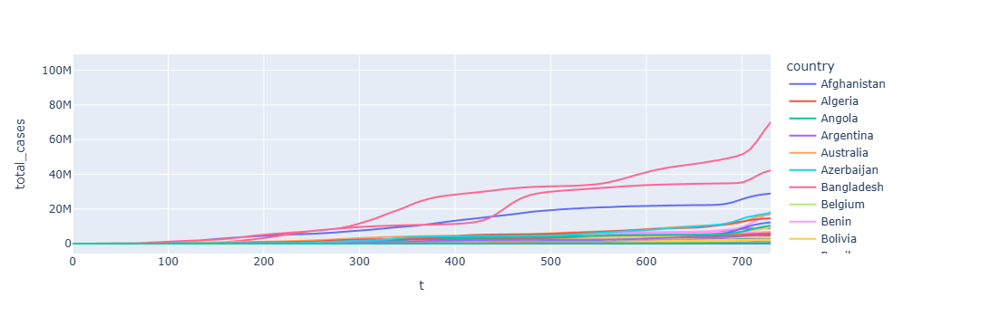

In [86]:
fig = px.line(covid19, x='t', y='total_cases', color='country')

fig.update_xaxes(range=[0, 2*365])    # Start the x-axis at day 0; End the x-axis at day 730 (i.e., 2 years worth of days)
fig.show()

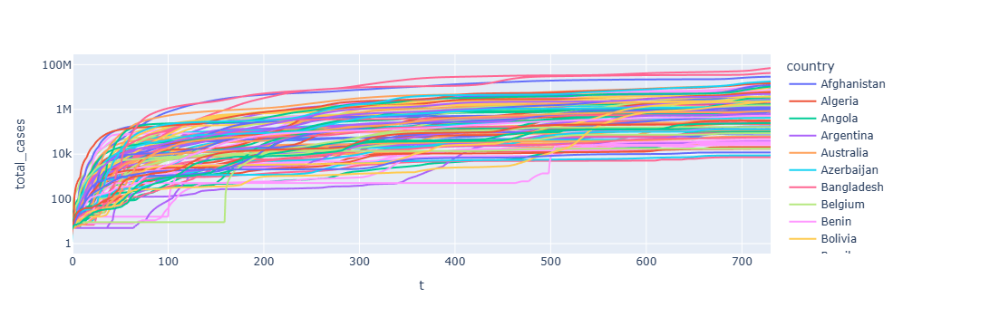

In [23]:
fig = px.line(covid19, x='t', y='total_cases', color='country', log_y = True)

fig.update_xaxes(range=[0, 2*365])
fig.update_layout(width = 700)
fig.show()

Pandemics often exhibit exponential growth during their initial stages, using log_y = True in Plotly will adjust the y-axis to a logarithmic scale. This helps better capture the rapid early spread of cases.

To make the visualization clear, will focus only on larger countries (those with populations over 50 million) and zoom in on the first six months of the pandemic.

In [88]:
focus = covid19[(covid19.population > 5e7) & (covid19.date < '2020-06-30')]
focus.head(2)

,country,date,continent,population,life_expectancy,gdp_per_capita,population_density,median_age,extreme_poverty,human_development_index,hospital_beds_per_thousand,percent_fully_vaccinated,total_cases,total_deaths,total_excess,t
10224,Bangladesh,2020-01-10,Asia,169384890,80.3684,6263,1301.259,24.99,5.008496,0.67,0.79,0.048011,0,0,<NA>,-68
10225,Bangladesh,2020-01-11,Asia,169384890,80.3684,6263,1301.259,24.99,5.008496,0.67,0.79,0.048011,0,0,<NA>,-67


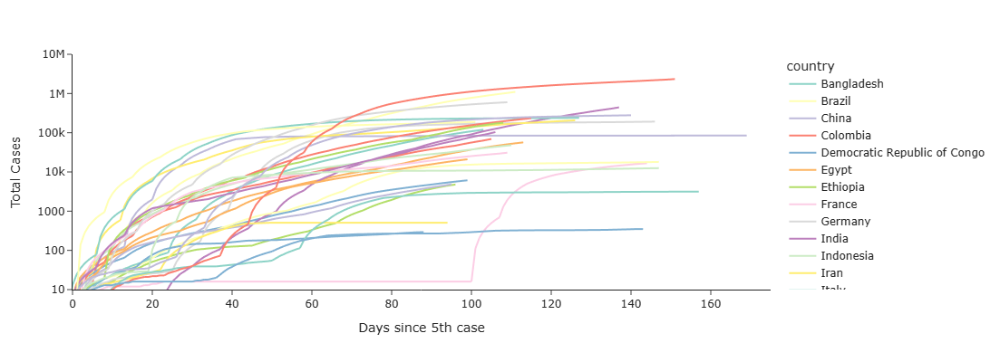

In [90]:
fig = px.line(focus, x='t', y='total_cases', color='country', log_y = True,
              hover_name='country', template='simple_white', color_discrete_sequence=px.colors.qualitative.Set3)

fig.update_xaxes(range=[0, 175],title='Days since 5th case')
fig.update_yaxes(range=[1, 7], title='Total Cases')
fig.update_layout(width = 800, height = 400)
fig.show()

In [29]:
# Creating Theoretical Benchmark to compare actual case trends against idealized growth rates
# tdouble = 2 (Rapid Spread); tdouble = 5 (Moderate Growth), tdouble = 10 (Slower Growth)

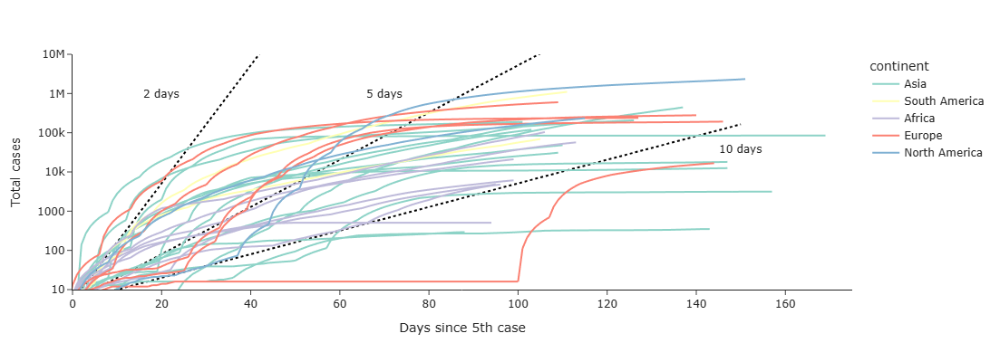

In [92]:
fig = px.line(focus, x='t', y='total_cases', color='continent', log_y=True,
              hover_name='country', template='simple_white', color_discrete_sequence=px.colors.qualitative.Set3)  # adding soft, pale color

fig.update_xaxes(range=[0, 175], title='Days since 5th case')      
fig.update_yaxes(range=[1, 7], title='Total cases')
fig.update_layout(width=600, height=400)

# Adding Exponential Growth Lines

for tdouble in [2, 5, 10]:
    fig.add_scatter(x=np.array([0, 150]),                                     # line from day 0 to day 150
                    y=np.array([5, 5 * 2**(150 / tdouble)]),                  # expected cases after 150 days of doubling at the rate tdouble (theoretical exponential growth)
                    mode='lines', showlegend=False, line=dict(color='black', dash='dot'))

# Labeling the Reference Lines

fig.update_layout(annotations=[{'x': 20,  'y': np.log10(1e6), 'text': '2 days',  'showarrow': False},
                               {'x': 70,  'y': np.log10(1e6), 'text': '5 days',  'showarrow': False},
                               {'x': 150, 'y': np.log10(4e4), 'text': '10 days', 'showarrow': False}])

fig.show()

The chart tells that after the 5th case, COVID-19 spread exponentially in many regions, but the pace of this spread varied significantly by continent. Regions whose case trajectories align with or exceed the 2-day doubling line experienced very rapid escalation, while those tracking closer to the 10-day line saw a slower increase. This dual approach—presenting both the actual data and the theoretical exponential benchmarks—helps to understand not just the numbers, but the dynamics of the outbreak, highlighting the potential impact of early interventions and public health measures.

In this particular visualization, none of the continent consistently followed the 2-day curve. While a curve might momentarily approach the 2-day benchmark during a surge, sustained growth at that rate would quickly lead to explosive numbers—something that, wasn’t seen in a prolonged manner.

At certain points, some continents curves are appearing to run parallel to the 5-day benchmark. This implies that, over those periods, the cumulative cases were doubling approximately every five days. For example, parts of a curve from a heavily affected region (like parts of Europe or North America).

Several continents (like Asia)—especially in later stages—tend to move toward or even below the 10-day benchmark. Indicating a slower growth rate. This could be the result of effective public health interventions, behavior changes among the population, or other epidemiological factors that helped to curb the infection rate.

In [32]:
# Saving the plot in HTML file

In [95]:
fig.write_html('cases.html')

In [97]:
import webbrowser

webbrowser.open('cases.html')

True